In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np
import matplotlib.pyplot as plt

import turboflow.utils.physics as ph

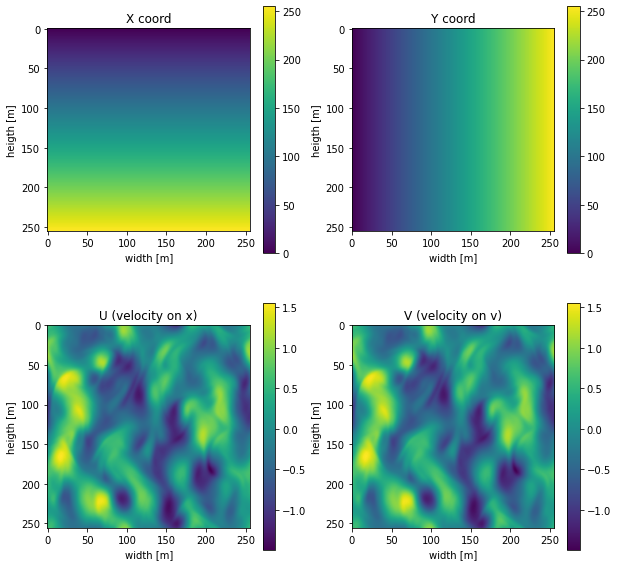

In [3]:
## SET UP DATA
img_dir = '../data/DNS_Scal/'
img_name = 'Scalar_36'
img_path = img_dir + img_name
img = np.loadtxt(open(img_path, "rb"), delimiter="\t")

X = img[:,0].reshape((256,256))
Y = img[:,1].reshape((256,256))
U = img[:,2].reshape((256,256))
V = img[:,3].reshape((256,256))

plt.figure(figsize=(10,10))
plt.subplot(221)
plt.imshow(X)
plt.title('X coord')
plt.xlabel('width [m]')
plt.ylabel('heigth [m]')
plt.colorbar()
plt.subplot(222)
plt.imshow(Y)
plt.title('Y coord')
plt.xlabel('width [m]')
plt.ylabel('heigth [m]')
plt.colorbar()
plt.subplot(223)
plt.imshow(U)
plt.title('U (velocity on x)')
plt.xlabel('width [m]')
plt.ylabel('heigth [m]')
plt.colorbar()
plt.subplot(224)
plt.imshow(U)
plt.title('V (velocity on v)')
plt.xlabel('width [m]')
plt.ylabel('heigth [m]')
plt.colorbar()
plt.show()

(256, 256)
(256, 256)
(256, 256)


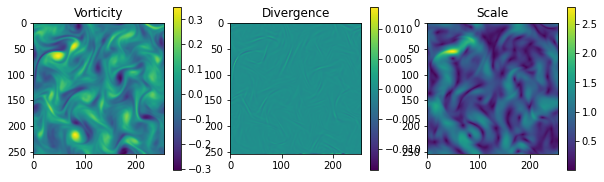

In [4]:
vorticity = ph.compute_vorticity(U, V)
print(vorticity.shape)
divergence = ph.compute_divergence(U, V)
print(divergence.shape)
scale = ph.compute_scale(U, V)
print(scale.shape)

plt.figure(figsize=(10,3))
plt.subplot(131)
plt.title('Vorticity')
plt.imshow(vorticity)
plt.colorbar()
plt.subplot(132)
plt.title('Divergence')
plt.imshow(divergence)
plt.colorbar()
plt.subplot(133)
plt.title('Scale')
plt.imshow(scale)
plt.colorbar()
plt.show()

<Figure size 720x720 with 0 Axes>

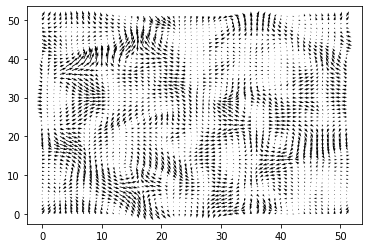

In [5]:
plt.figure(figsize=(10,10))
ph.plot_field(U, V, step=5)
plt.show()

<Figure size 720x720 with 0 Axes>

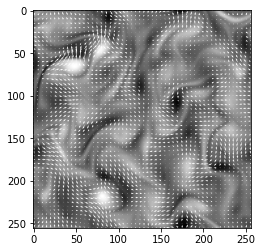

In [6]:
plt.figure(figsize=(10,10))
ph.plot_field(U, V, step=5, img=vorticity)
plt.show()

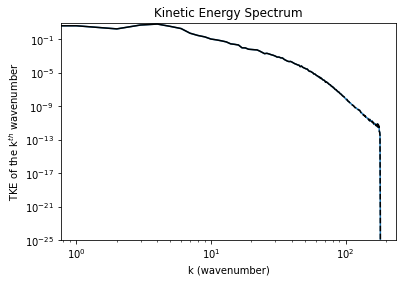

In [7]:
Kspec_turbulence = ph.powerspec(U)
ph.plot_energy_spec(Kspec_turbulence)
plt.show()

In [8]:
def plot_Scal_turbulences(index):
    
    img_dir = '../data/DNS_Scal/'
    img_name = 'Scalar_%02d' % index
    img_path = img_dir + img_name
    img = np.loadtxt(open(img_path, "rb"), delimiter="\t")

    X = img[:,0].reshape((256,256))
    Y = img[:,1].reshape((256,256))
    U = img[:,2].reshape((256,256))
    V = img[:,3].reshape((256,256))
    
    return U

#     vorticity = ph.compute_vorticity(U, V)
#     scale = ph.compute_scale(U, V)

#     Kspec_turbulence = ph.powerspec(U)

#     fig, axarr = plt.subplots(2,3,figsize=(30,20))

#     axarr[0,0].imshow(U)
#     axarr[0,0].set_title('U (velocity on x)')
#     axarr[0,0].set_xlabel('width [m]')
#     axarr[0,0].set_ylabel('heigth [m]')

#     axarr[0,1].imshow(U)
#     axarr[0,1].set_title('V (velocity on v)')
#     axarr[0,1].set_xlabel('width [m]')
#     axarr[0,1].set_ylabel('heigth [m]')

#     axarr[1,0].imshow(vorticity)
#     axarr[1,0].set_title('Vorticity')
#     axarr[1,0].set_xlabel('width [m]')
#     axarr[1,0].set_ylabel('heigth [m]')

#     ph.plot_field(U, V, step=5, ax=axarr[1,1])
#     axarr[1,1].set_title('Velocity Field')
#     axarr[1,1].set_xlabel('width [m]')
#     axarr[1,1].set_ylabel('heigth [m]')

#     ph.plot_energy_spec(Kspec_turbulence, ax=axarr[0,2])
#     axarr[0,2].set_title('TKE Energy')

In [9]:
import matplotlib.pyplot as plt

for i in range(50):
    U = plot_Scal_turbulences()
    plt.pause(0.5)

TypeError: plot_Scal_turbulences() missing 1 required positional argument: 'index'

In [10]:
def get_turbulence_scal(index):

    img_dir = '../data/DNS_Scal/'
    img_name = 'Scalar_%02d' % index
    print(img_name)
    img_path = img_dir + img_name
    img = np.loadtxt(open(img_path, "rb"), delimiter="\t")

    U = img[:,2].reshape((256,256))
    V = img[:,3].reshape((256,256))
    
    X = ph.compute_vorticity(U, V)
    S = ph.compute_scale(U, V)
    
    return U, V, X, S

U = np.zeros((256,256,50))
V = np.zeros((256,256,50))
X = np.zeros((256,256,50))
S = np.zeros((256,256,50))

for i in tqdm(range(50)):
    U[:,:,i], V[:,:,i], X[:,:,i], S[:,:,i] = get_turbulence_scal(i)

NameError: name 'tqdm' is not defined

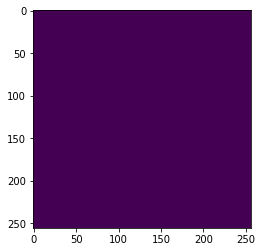

In [11]:
plt.imshow(U[:,:,10])

nan
nan
nan
nan


<ipython-input-12-1cbe01ba934e>:2: RuntimeWarning: invalid value encountered in true_divide
  Unorm = U / np.max(np.abs(U))
<ipython-input-12-1cbe01ba934e>:3: RuntimeWarning: invalid value encountered in true_divide
  Vnorm = V / np.max(np.abs(V))
<ipython-input-12-1cbe01ba934e>:4: RuntimeWarning: invalid value encountered in true_divide
  Snorm = S / np.max(np.abs(S))
<ipython-input-12-1cbe01ba934e>:5: RuntimeWarning: invalid value encountered in true_divide
  Xnorm = X / np.max(np.abs(X))


/home/dicarlo_d/Documents/Code/TurboSuperResultion/venv/lib/python3.8/site-packages/matplotlib/image.py:443: UserWarning: Warning: converting a masked element to nan.
  dv = np.float64(self.norm.vmax) - np.float64(self.norm.vmin)
/home/dicarlo_d/Documents/Code/TurboSuperResultion/venv/lib/python3.8/site-packages/matplotlib/image.py:444: UserWarning: Warning: converting a masked element to nan.
  vmid = np.float64(self.norm.vmin) + dv / 2


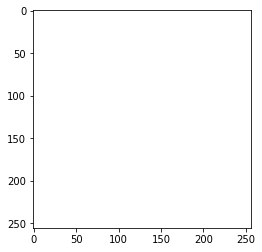

In [12]:
# normalize
Unorm = U / np.max(np.abs(U))
Vnorm = V / np.max(np.abs(V))
Snorm = S / np.max(np.abs(S))
Xnorm = X / np.max(np.abs(X))
print(np.max(np.abs(Unorm)))
print(np.max(np.abs(Vnorm)))
print(np.max(np.abs(Snorm)))
print(np.max(np.abs(Xnorm)))

plt.imshow(Unorm[:,:,10])

In [13]:
import matplotlib.animation as animation
from IPython.display import HTML
from tqdm.notebook import tqdm

fig, axarr = plt.subplots(2,2, figsize=(10,10))


# ims is a list of lists, each row is a list of artists to draw in the
# current frame; here we are just animating one artist, the image, in
# each frame
ims = []
for i in tqdm(range(50)):
       
    im1 = axarr[0,0].imshow(Unorm[:,:,i], vmin=-1, vmax=1, animated=True)
    im2 = axarr[0,1].imshow(Vnorm[:,:,i], vmin=-1, vmax=1, animated=True)
    im3 = axarr[1,0].imshow(Xnorm[:,:,i], vmin=-1, vmax=1, animated=True)
    im4 = axarr[1,1].imshow(Snorm[:,:,i], vmin=-1, vmax=1, animated=True)
    
    ims.append([im1, im2, im3, im4])
    
ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True, repeat_delay=1000)

plt.close()

# Show the animation
HTML(ani.to_html5_video())

  0%|          | 0/50 [00:00<?, ?it/s]

In [14]:
fig, ax = plt.subplots(figsize=(10,10))

# ims is a list of lists, each row is a list of artists to draw in the
# current frame; here we are just animating one artist, the image, in
# each frame
ims = []
step = 5
scale = 20

for i in tqdm(range(50)):
    
    im = ph.plot_field(U[:,:,i],V[:,:,i],scale=5,step=5,img=X[:,:,i], ax=ax)
        
    ims.append([im])
    
ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True, repeat_delay=1000)

plt.close()

# Show the animation
HTML(ani.to_html5_video())

  0%|          | 0/50 [00:00<?, ?it/s]

/home/dicarlo_d/Documents/Code/TurboSuperResultion/venv/lib/python3.8/site-packages/matplotlib/quiver.py:679: RuntimeWarning: divide by zero encountered in double_scalars
  length = a * (widthu_per_lenu / (self.scale * self.width))
/home/dicarlo_d/Documents/Code/TurboSuperResultion/venv/lib/python3.8/site-packages/matplotlib/quiver.py:679: RuntimeWarning: invalid value encountered in multiply
  length = a * (widthu_per_lenu / (self.scale * self.width))
/home/dicarlo_d/Documents/Code/TurboSuperResultion/venv/lib/python3.8/site-packages/matplotlib/quiver.py:679: RuntimeWarning: divide by zero encountered in double_scalars
  length = a * (widthu_per_lenu / (self.scale * self.width))
/home/dicarlo_d/Documents/Code/TurboSuperResultion/venv/lib/python3.8/site-packages/matplotlib/quiver.py:679: RuntimeWarning: invalid value encountered in multiply
  length = a * (widthu_per_lenu / (self.scale * self.width))


CalledProcessError: Command '['ffmpeg', '-f', 'rawvideo', '-vcodec', 'rawvideo', '-s', '720x720', '-pix_fmt', 'rgba', '-r', '20.0', '-loglevel', 'error', '-i', 'pipe:', '-vcodec', 'h264', '-pix_fmt', 'yuv420p', '-y', '/tmp/tmp8ijor80s/temp.m4v']' returned non-zero exit status 255.

In [35]:
img_dir = '../../../Datasets/2021-Turb2D/scalar/'

import glob
from PIL import Image


imgs = glob.glob(img_dir + '*.tif')
N = len(imgs)

X = np.zeros((256,256,N))

for i, img_path in enumerate(imgs):
    im = Image.open(img_path)
    X[:,:,i] = np.array(im)
    
print(X.shape)

(256, 256, 1000)


In [37]:
fig, ax = plt.subplots(figsize=(10,10))
ims = []
for i in tqdm(range(N)):
    
    im = plt.imshow(X[:,:,i], animated=True)
        
    ims.append([im])
    
ani = animation.ArtistAnimation(fig, ims, interval=200, blit=True, repeat_delay=1000)

plt.close()

# Show the animation
HTML(ani.to_html5_video())

  0%|          | 0/1000 [00:00<?, ?it/s]